In [25]:
import requests
import pandas as pd
import sys, json
import json
import string
import datetime as dt
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

url="https://archive.org/advancedsearch.php?q=(mystery+OR+mysterious)+AND+illness&output=json&rows=50000"

In [26]:
response = requests.get(url).json()

In [27]:
response

{'responseHeader': {'status': 0,
  'QTime': 306,
  'params': {'query': '( (title:mystery^100 OR salients:mystery^50 OR subject:mystery^25 OR description:mystery^15 OR collection:mystery^10 OR language:mystery^10 OR text:mystery^1) OR (title:mysterious^100 OR salients:mysterious^50 OR subject:mysterious^25 OR description:mysterious^15 OR collection:mysterious^10 OR language:mysterious^10 OR text:mysterious^1) ) AND (title:illness^100 OR salients:illness^50 OR subject:illness^25 OR description:illness^15 OR collection:illness^10 OR language:illness^10 OR text:illness^1)',
   'qin': '(mystery OR mysterious) AND illness',
   'fields': '_default_',
   'wt': 'json',
   'rows': '50000',
   'start': 0}},
 'response': {'numFound': 847,
  'start': 0,
  'docs': [{'backup_location': 'ia905909_32',
    'btih': 'b976dd1f202c53e123e3360f92651a8a36818078',
    'collection': ['Mental_Illness_Happy_Hour', 'podcasts_mirror'],
    'creator': 'Mental Illness Happy Hour',
    'date': '2012-10-26T00:00:00Z',

In [28]:
response['response']['docs'][1]['date']

'2011-08-12T00:00:00Z'

In [55]:
dates = [""]*9999
for count,row in enumerate(response['response']['docs']):
    try:
        dates[count]=row['publicdate']
    except:
        try:
            dates[count]=row['date']
        except:
            pass


In [56]:
dates

['2015-01-19T00:37:25Z',
 '2015-01-18T16:17:16Z',
 '2015-01-18T19:25:10Z',
 '2019-09-30T11:01:23Z',
 '2018-04-12T02:37:35Z',
 '2020-12-04T05:57:53Z',
 '2020-12-13T23:04:31Z',
 '2015-06-05T17:41:50Z',
 '2020-03-21T18:05:22Z',
 '2018-09-05T20:25:23Z',
 '2019-09-28T20:23:33Z',
 '2014-07-13T06:00:00Z',
 '2018-04-12T01:30:05Z',
 '2020-12-27T09:00:01Z',
 '2020-08-17T07:25:24Z',
 '2019-08-04T21:41:48Z',
 '2020-11-21T18:37:32Z',
 '2019-04-20T08:00:19Z',
 '2019-02-15T16:23:35Z',
 '2020-09-19T00:16:42Z',
 '2020-01-12T00:30:00Z',
 '2021-03-15T20:35:12Z',
 '2016-05-16T12:25:01Z',
 '2011-09-27T20:37:15Z',
 '2016-06-26T07:04:11Z',
 '2019-08-04T10:37:18Z',
 '2019-10-03T06:34:17Z',
 '2019-09-01T04:50:12Z',
 '2019-08-04T00:00:07Z',
 '2019-06-26T01:06:20Z',
 '2020-12-23T17:36:10Z',
 '2016-11-04T20:23:26Z',
 '2018-11-01T07:42:18Z',
 '2018-07-04T07:22:04Z',
 '2013-08-28T06:01:21Z',
 '2016-05-02T12:21:51Z',
 '2012-05-23T23:51:10Z',
 '2020-03-28T08:45:06Z',
 '2019-09-26T12:12:25Z',
 '2020-06-11T14:08:10Z',


In [57]:
dates = [x for x in dates if x]

In [58]:
dates = [x for x in dates if str(dates[0]) != "0"]

In [59]:
dates

['2015-01-19T00:37:25Z',
 '2015-01-18T16:17:16Z',
 '2015-01-18T19:25:10Z',
 '2019-09-30T11:01:23Z',
 '2018-04-12T02:37:35Z',
 '2020-12-04T05:57:53Z',
 '2020-12-13T23:04:31Z',
 '2015-06-05T17:41:50Z',
 '2020-03-21T18:05:22Z',
 '2018-09-05T20:25:23Z',
 '2019-09-28T20:23:33Z',
 '2014-07-13T06:00:00Z',
 '2018-04-12T01:30:05Z',
 '2020-12-27T09:00:01Z',
 '2020-08-17T07:25:24Z',
 '2019-08-04T21:41:48Z',
 '2020-11-21T18:37:32Z',
 '2019-04-20T08:00:19Z',
 '2019-02-15T16:23:35Z',
 '2020-09-19T00:16:42Z',
 '2020-01-12T00:30:00Z',
 '2021-03-15T20:35:12Z',
 '2016-05-16T12:25:01Z',
 '2011-09-27T20:37:15Z',
 '2016-06-26T07:04:11Z',
 '2019-08-04T10:37:18Z',
 '2019-10-03T06:34:17Z',
 '2019-09-01T04:50:12Z',
 '2019-08-04T00:00:07Z',
 '2019-06-26T01:06:20Z',
 '2020-12-23T17:36:10Z',
 '2016-11-04T20:23:26Z',
 '2018-11-01T07:42:18Z',
 '2018-07-04T07:22:04Z',
 '2013-08-28T06:01:21Z',
 '2016-05-02T12:21:51Z',
 '2012-05-23T23:51:10Z',
 '2020-03-28T08:45:06Z',
 '2019-09-26T12:12:25Z',
 '2020-06-11T14:08:10Z',


In [60]:
lastdates=len(dates)
newdates=0
while (newdates != lastdates):
    lastdates=newdates
    for i,row in enumerate(dates):    
        if dates[i][:4] < '2018':
            del dates[i]
            newdates=len(dates)

In [61]:
len(dates)

600

In [62]:
min(dates)

'2018-01-02T23:29:06Z'

In [63]:
max(dates)

'2021-10-01T14:25:32Z'

In [64]:
df = pd.DataFrame(dates)
#df = df.value_counts().sort_index()

In [65]:
df[0] = pd.to_datetime(df[0], dayfirst=True)

df1 = df[0].dt.date.value_counts().sort_index().reset_index()

df1.columns = ['DATE','Count']

In [66]:
df1['DATE'] = pd.to_datetime(df1['DATE'])

In [67]:
df1.set_index('DATE', inplace=True)

In [68]:
df1

,Count
DATE,
2018-01-02,1
2018-01-03,1
2018-01-04,1
2018-01-25,1
2018-01-29,1
...,...
2021-09-16,1
2021-09-22,1
2021-09-28,2


In [69]:
# drop the first row if nonsense
# df1.drop(df1.index[0],inplace=True)

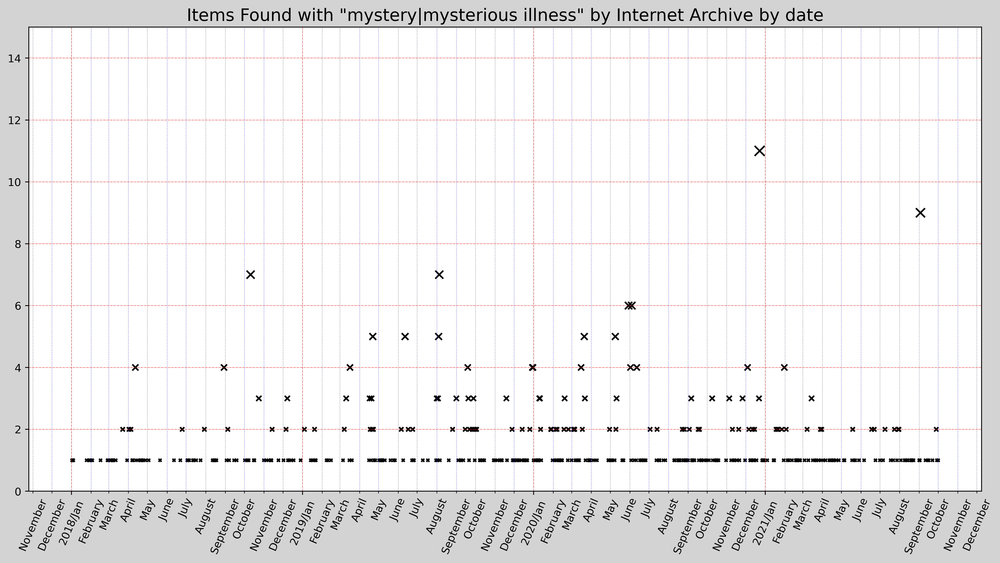

In [70]:
%matplotlib inline
x = df1.index
y = df1['Count']

fig= plt.figure(figsize=(16, 8), dpi=400,facecolor='lightgray')

plt.gca().xaxis.set_minor_formatter(mdates.DateFormatter('%B'))
plt.gca().xaxis.set_minor_locator(mdates.MonthLocator())
plt.gca().tick_params(axis="x", which="both", rotation=67)
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y/%b'))
plt.gca().xaxis.set_major_locator(mdates.YearLocator())
plt.scatter(x,y,s=y*8,marker='x',color='k')
plt.gca().grid(which='major', color='r', linestyle='-.', linewidth=.3, alpha=1)  
plt.gca().grid(which='minor', color='b', linestyle='-.', linewidth=.2,alpha=.7)
plt.ylim(top=15,bottom=0)
plt.title('Items Found with "mystery|mysterious illness" by Internet Archive by date',size=16)

plt.show()
plt.close()

In [ ]:

import matplotlib.pyplot as plt
from matplotlib import cm
import numpy as np
from celluloid import Camera

fig = plt.figure(figsize=(16, 9), dpi=300,facecolor='lightgray')
ax=  fig.gca()
ax.xaxis.set_minor_formatter(mdates.DateFormatter('%B'))
ax.xaxis.set_minor_locator(mdates.MonthLocator())
ax.tick_params(axis="x", which="both", rotation=67)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%Y/%b'))
ax.xaxis.set_major_locator(mdates.YearLocator())
ax.grid(which='major', color='r', linestyle='-.', linewidth=.3, alpha=1)  
ax.grid(which='minor', color='b', linestyle='-.', linewidth=.2,alpha=.7)
ax.set_ylim(top=100,bottom=0)

plt.title('Items Found with "Wuhan" by Internet Archive by date',size=16)

rows = []
a = 0
camera = Camera(fig)
for i,row in df1.iterrows():
    rows=df1[:i]
    ax.scatter(rows['Count'].index,rows['Count'],s=rows['Count']*4,marker='x',color='k')
    camera.snap()

anim = camera.animate(blit=False)

anim.save('scatter.gif',fps=60)

plt.show()
plt.close()